In [14]:
import pandas as pd
from ydata_profiling import ProfileReport
fouls_df = pd.read_excel('fouls_review.xlsx')
report = ProfileReport(fouls_df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
print(fouls_df.groupby('Home', as_index= False)['fouls_home'].mean().sort_values(['fouls_home']))

                     Home  fouls_home
15                  Zenit    9.428571
13                 Samara    9.833333
8        Lokomotiv Moscow   10.636364
2           Dynamo Moscow   11.133333
1             CSKA Moscow   11.785714
11                 Rostov   11.818182
10               Orenburg   12.076923
0           Akhmat Grozny   12.181818
14         Spartak Moscow   13.076923
7               Krasnodar   13.230769
6          Fakel Voronezh   13.454545
4               FC Khimki   13.500000
9         Nizhny Novgorod   13.545455
3   FC Dynamo Makhachkala   14.000000
12            Rubin Kazan   14.600000
5       FK Akron Tolyatti   16.000000


In [18]:
print(fouls_df.groupby('Away', as_index= False)['fouls_away'].mean().sort_values(['fouls_away']))

                     Away  fouls_away
15                  Zenit    8.846154
11                 Rostov   10.307692
3   FC Dynamo Makhachkala   11.000000
10               Orenburg   11.300000
13                 Samara   11.636364
1             CSKA Moscow   11.642857
5       FK Akron Tolyatti   12.000000
0           Akhmat Grozny   12.500000
2           Dynamo Moscow   12.545455
12            Rubin Kazan   12.727273
8        Lokomotiv Moscow   12.769231
14         Spartak Moscow   13.000000
7               Krasnodar   13.500000
6          Fakel Voronezh   13.571429
9         Nizhny Novgorod   14.222222
4               FC Khimki   14.500000


In [28]:
sorted_fouls = fouls_df.groupby('Referee', as_index=False)['total_fouls'].agg(['mean', 'count']).sort_values('mean')
print(sorted_fouls)

                 Referee       mean  count
15        Sergey Karasev  21.705882     17
11          Roman Safyan  22.000000      1
8          Pavel Kukuyan  22.230769     13
7        Kirill Levnikov  22.866667     15
2       Artem Chistyakov  22.900000     10
16       Sergey Tsyganok  23.000000      1
6        Evgeny Kukulyak  23.454545     11
13        Sergey Cyganok  23.500000      2
1         Aleksey Sukhoy  23.833333     12
0         Aleksey Amelin  24.000000      2
20  Vladislav Bezborodov  24.300000     10
9      Pavel Shadykhanov  24.375000      8
17     Vasiliy Kazartsev  24.571429      7
10        Rafael Shafeev  24.777778      9
5         Evgeny Bulanov  25.166667      6
19     Vladimir Moskalev  25.166667      6
14         Sergey Ivanov  26.000000     11
18        Vitaly Meshkov  26.000000      9
21        Yan Bobrovskiy  26.000000      4
4            Egor Egorov  27.000000      1
12         Sergei Cheban  27.333333      3
3         Artem Lyubimov  32.200000      5


In [48]:
grouped_df = fouls_df.groupby('Home', as_index=False)[['possession_home', 'fouls_home', 'fouls_away']].mean().sort_values(['possession_home'])
correlation_matrix = grouped_df[['possession_home', 'fouls_home', 'fouls_away']].corr()
correlation_matrix

,possession_home,fouls_home,fouls_away
possession_home,1.000000,-0.328455,0.126190
fouls_home,-0.328455,1.000000,-0.039216
fouls_away,0.126190,-0.039216,1.000000


In [30]:
print(fouls_df.groupby('Away', as_index= False)['possession_away'].mean().sort_values(['possession_away']))

                     Away  possession_away
0           Akhmat Grozny        39.083333
9         Nizhny Novgorod        39.777778
12            Rubin Kazan        41.545455
6          Fakel Voronezh        41.642857
3   FC Dynamo Makhachkala        44.000000
1             CSKA Moscow        44.500000
2           Dynamo Moscow        47.454545
10               Orenburg        47.700000
13                 Samara        50.727273
8        Lokomotiv Moscow        51.076923
5       FK Akron Tolyatti        53.666667
11                 Rostov        55.076923
7               Krasnodar        55.916667
14         Spartak Moscow        57.416667
4               FC Khimki        61.500000
15                  Zenit        61.769231


Распределение fouls_home для Home = Orenburg:
count    13.000000
mean     12.076923
std       2.985005
min       9.000000
25%      10.000000
50%      11.000000
75%      14.000000
max      19.000000
Name: fouls_home, dtype: float64

90% диапазон: [ 9.  17.2]

Распределение fouls_away для Away = Rostov:
count    13.000000
mean     10.307692
std       2.562050
min       6.000000
25%       9.000000
50%      11.000000
75%      12.000000
max      15.000000
Name: fouls_away, dtype: float64

90% диапазон: [ 6.  13.8]


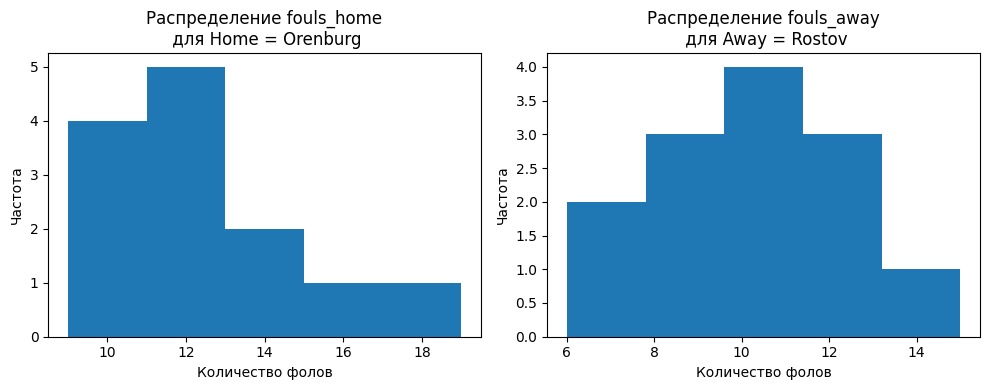

In [39]:
import matplotlib.pyplot as plt
%matplotlib inline

# 1. Фильтруем данные для Home = Orenburg по fouls_home
orenburg_home_fouls = fouls_df.loc[fouls_df["Home"] == "Orenburg", "fouls_home"]

# 2. Фильтруем данные для Away = Rostov по fouls_away
rostov_away_fouls = fouls_df.loc[fouls_df["Away"] == "Rostov", "fouls_away"]

# 3. Вычисляем квантили для определения диапазона 90% наблюдений
orenburg_home_fouls_quantiles = orenburg_home_fouls.quantile([0.05, 0.95])
rostov_away_fouls_quantiles = rostov_away_fouls.quantile([0.05, 0.95])

print("Распределение fouls_home для Home = Orenburg:")
print(orenburg_home_fouls.describe())
print("\n90% диапазон:", orenburg_home_fouls_quantiles.values)

print("\nРаспределение fouls_away для Away = Rostov:")
print(rostov_away_fouls.describe())
print("\n90% диапазон:", rostov_away_fouls_quantiles.values)

# Построение графиков

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.hist(orenburg_home_fouls, bins=5)
plt.title("Распределение fouls_home\n для Home = Orenburg")
plt.xlabel("Количество фолов")
plt.ylabel("Частота")

plt.subplot(1, 2, 2)
plt.hist(rostov_away_fouls, bins=5)
plt.title("Распределение fouls_away\n для Away = Rostov")
plt.xlabel("Количество фолов")
plt.ylabel("Частота")

plt.tight_layout()
plt.show()

In [40]:
import pandas as pd
from scipy import stats

# 1. Фильтруем данные для Home = Orenburg по fouls_home
orenburg_home_fouls = fouls_df.loc[fouls_df["Home"] == "Orenburg", "fouls_home"]

# 2. Фильтруем данные для Away = Rostov по fouls_away
rostov_away_fouls = fouls_df.loc[fouls_df["Away"] == "Rostov", "fouls_away"]

# Доверительный интервал для разницы средних:
confidence = 0.90  # Уровень доверия
n1 = len(orenburg_home_fouls)
n2 = len(rostov_away_fouls)
mean1 = orenburg_home_fouls.mean()
mean2 = rostov_away_fouls.mean()
std1 = orenburg_home_fouls.std()
std2 = rostov_away_fouls.std()

# Стандартная ошибка разницы средних:
se = ((std1**2 / n1) + (std2**2 / n2))**0.5

# Критическое значение t-распределения:
t_critical = stats.t.ppf((1 + confidence) / 2, df=min(n1-1, n2-1))

# Границы доверительного интервала:
margin_of_error = t_critical * se
confidence_interval = (mean1 - mean2 - margin_of_error,
                       mean1 - mean2 + margin_of_error)

print("Доверительный интервал для разницы средних (90%):", confidence_interval)

Доверительный интервал для разницы средних (90%): (-0.1752893111340985, 3.713750849595635)


Доверительный интервал для суммы фолов (90%): (nan, nan)


In [51]:
fouls_df.columns

Index(['Unnamed: 0', 'Date', 'Home', 'Away', 'Referee', 'fouls_home',
       'fouls_away', 'possession_home', 'possession_away', 'home_team_index',
       'away_team_index', 'referee_index', 'total_fouls', 'home_fouls_avg',
       'away_fouls_avg', 'home_possession_avg', 'away_possession_avg',
       'referee_avg', 'home_total_fouls_avg', 'away_total_fouls_avg',
       'home_total_possession_avg', 'away_total_possession_avg',
       'total_b_20.5', 'total_b_21.5', 'total_b_22.5', 'total_b_23.5',
       'total_b_24.5', 'total_b_25.5', 'total_b_26.5', 'total_b_27.5',
       'total_b_28.5', 'total_b_29.5', 'fora_1_-0.5', 'fora_1_-1.5',
       'fora_1_-2.5', 'fora_1_-3.5', 'fora_1_-4.5', 'fora_1_-5.5',
       'fora_1_-6.5', 'fora_1_-7.5', 'fora_1_-8.5', 'fora_1_-9.5',
       'fora_1_+0.5', 'fora_1_+1.5', 'fora_1_+2.5', 'fora_1_+3.5',
       'fora_1_+4.5', 'fora_1_+5.5', 'fora_1_+6.5', 'fora_1_+7.5',
       'fora_1_+8.5', 'fora_1_+9.5'],
      dtype='object')

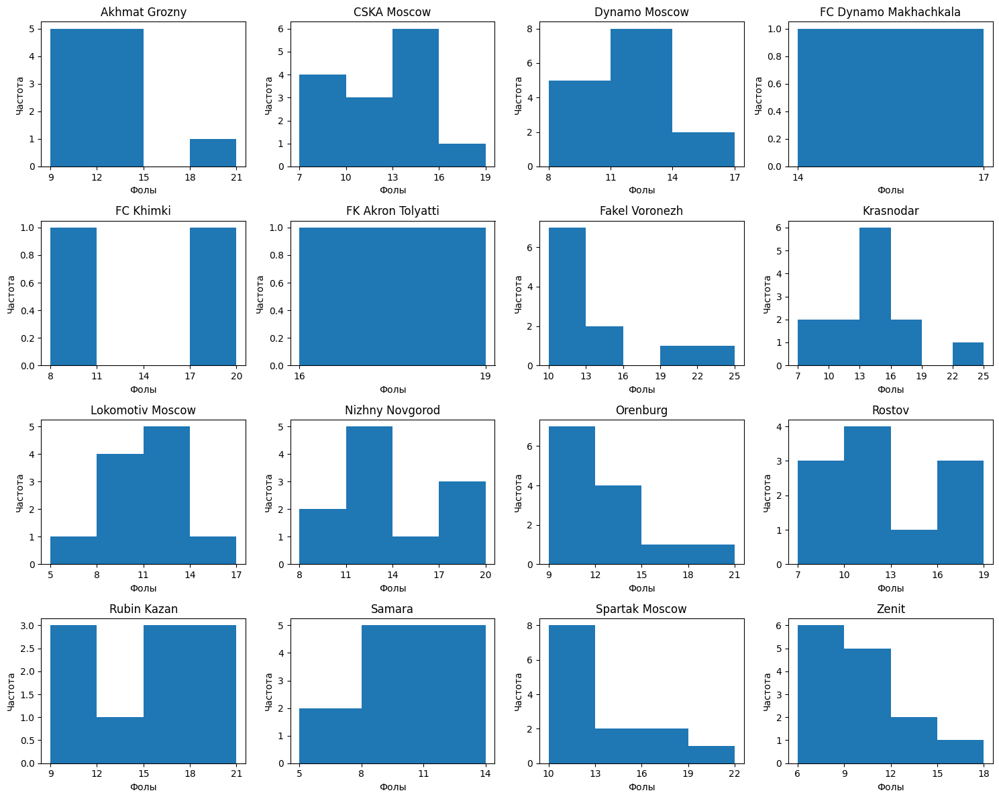

In [61]:
import matplotlib.pyplot as plt
import pandas as pd 
%matplotlib inline 

# Предположим, у тебя есть DataFrame с именем fouls_df, содержащий столбцы 'Home', 'fouls_home'

# Группируем данные по домашним командам
home_teams = fouls_df.groupby('Home')

# Группируем данные по домашним командам
home_teams = fouls_df.groupby('Home')

# Определяем количество строк и столбцов для сабплотов
n_rows = 4  # Количество строк
n_cols = 4  # Количество столбцов

# Создаем фигуру и оси для сабплотов
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 12)) 

# Индекс для перебора сабплотов
plot_index = 0

# Создаем гистограммы для каждой команды
for team, data in home_teams:
    # Определяем текущие строку и столбец для сабплота
    row = plot_index // n_cols 
    col = plot_index % n_cols
    
    # Извлекаем данные о фолах для текущей команды
    fouls = data['fouls_home']
    
    # Строим гистограмму на соответствующем сабплоте
    axes[row, col].hist(fouls, bins=range(min(fouls), max(fouls) + 4, 3)) # Шаг = 3
    axes[row, col].set_title(f'{team}')
    axes[row, col].set_xlabel('Фолы')
    axes[row, col].set_ylabel('Частота')

    # Настраиваем шаг меток на оси X
    min_tick = min(fouls)
    max_tick = max(fouls) + 3 # Добавляем 3 для корректного отображения последней метки
    axes[row, col].set_xticks(np.arange(min_tick, max_tick + 1, 3))

    plot_index += 1

# Удаляем пустые сабплоты, если количество команд меньше 16
if plot_index < n_rows * n_cols:
    for i in range(plot_index, n_rows * n_cols):
        fig.delaxes(axes.flatten()[i])

# Настройка расположения сабплотов
plt.tight_layout() 
plt.show()

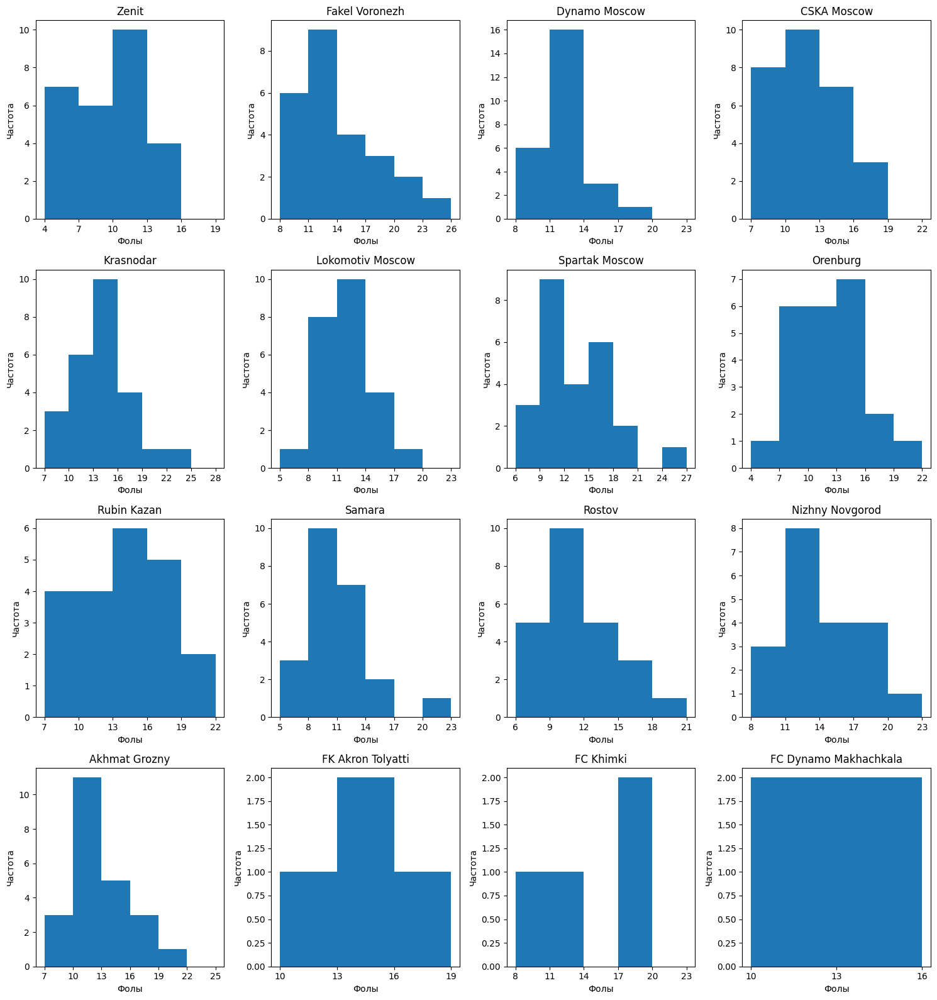

In [59]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Предположим, у тебя есть DataFrame с именем fouls_df, 
# содержащий столбцы 'Home', 'fouls_home', 'Away', 'fouls_away'

# Создаем словарь для хранения данных о фолах для каждой команды
all_teams_fouls = {}

# Итерируемся по строкам DataFrame
for index, row in fouls_df.iterrows():
    home_team = row['Home']
    away_team = row['Away']
    home_fouls = row['fouls_home']
    away_fouls = row['fouls_away']

    # Добавляем фолы домашней команды
    if home_team in all_teams_fouls:
        all_teams_fouls[home_team].append(home_fouls)
    else:
        all_teams_fouls[home_team] = [home_fouls]

    # Добавляем фолы гостевой команды
    if away_team in all_teams_fouls:
        all_teams_fouls[away_team].append(away_fouls)
    else:
        all_teams_fouls[away_team] = [away_fouls]

# Определяем количество строк и столбцов для сабплотов
n_teams = len(all_teams_fouls)
n_cols = 4  # Количество столбцов 
n_rows = (n_teams + n_cols - 1) // n_cols  # Вычисляем количество строк

# Создаем фигуру и оси для сабплотов
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 4*n_rows))

# Индекс для перебора сабплотов
plot_index = 0

# Строим гистограммы для каждой команды
for team, fouls in all_teams_fouls.items():
    # Определяем текущие строку и столбец для сабплота
    row = plot_index // n_cols
    col = plot_index % n_cols

    # Строим гистограмму на соответствующем сабплоте
    axes[row, col].hist(fouls, bins=range(min(fouls), max(fouls) + 5, 3))
    axes[row, col].set_title(f'{team}')
    axes[row, col].set_xlabel('Фолы')
    axes[row, col].set_ylabel('Частота')

    # Настраиваем шаг меток на оси X
    min_tick = min(fouls)
    max_tick = max(fouls) + 4 # Добавляем 4, чтобы последняя метка отображалась
    axes[row, col].set_xticks(np.arange(min_tick, max_tick + 1, 3))

    plot_index += 1

# Удаляем пустые сабплоты, если количество команд не кратно количеству столбцов
if plot_index < n_rows * n_cols:
    for i in range(plot_index, n_rows * n_cols):
        fig.delaxes(axes.flatten()[i])

# Настройка расположения сабплотов
plt.tight_layout()
plt.show()

In [64]:
print(fouls_df.groupby('Home', as_index= False)['fouls_home'].count().sort_values(['fouls_home']))

                     Home  fouls_home
3   FC Dynamo Makhachkala           1
5       FK Akron Tolyatti           1
4               FC Khimki           2
12            Rubin Kazan          10
0           Akhmat Grozny          11
6          Fakel Voronezh          11
8        Lokomotiv Moscow          11
9         Nizhny Novgorod          11
11                 Rostov          11
13                 Samara          12
7               Krasnodar          13
10               Orenburg          13
14         Spartak Moscow          13
1             CSKA Moscow          14
15                  Zenit          14
2           Dynamo Moscow          15


In [66]:
print(fouls_df.groupby('Away', as_index= False)['fouls_away'].count().sort_values(['fouls_away']))

                     Away  fouls_away
4               FC Khimki           2
3   FC Dynamo Makhachkala           3
5       FK Akron Tolyatti           3
9         Nizhny Novgorod           9
10               Orenburg          10
2           Dynamo Moscow          11
12            Rubin Kazan          11
13                 Samara          11
0           Akhmat Grozny          12
7               Krasnodar          12
14         Spartak Moscow          12
8        Lokomotiv Moscow          13
11                 Rostov          13
15                  Zenit          13
1             CSKA Moscow          14
6          Fakel Voronezh          14


In [73]:
original_df = pd.read_excel('just_to_share.xlsx')
original_df = original_df[(original_df['fouls_home'].notna())& (original_df['fouls_home'] != 0) ]
report = ProfileReport(original_df)
report


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [70]:
print(original_df.groupby('Away', as_index= False)['fouls_away'].count().sort_values(['fouls_away']))

                     Away  fouls_away
4               FC Khimki           3
3   FC Dynamo Makhachkala           4
5       FK Akron Tolyatti           4
2           Dynamo Moscow          14
13                 Samara          14
0           Akhmat Grozny          15
1             CSKA Moscow          15
6          Fakel Voronezh          15
7               Krasnodar          15
8        Lokomotiv Moscow          15
9         Nizhny Novgorod          15
10               Orenburg          15
11                 Rostov          15
12            Rubin Kazan          15
14         Spartak Moscow          15
15                  Zenit          15


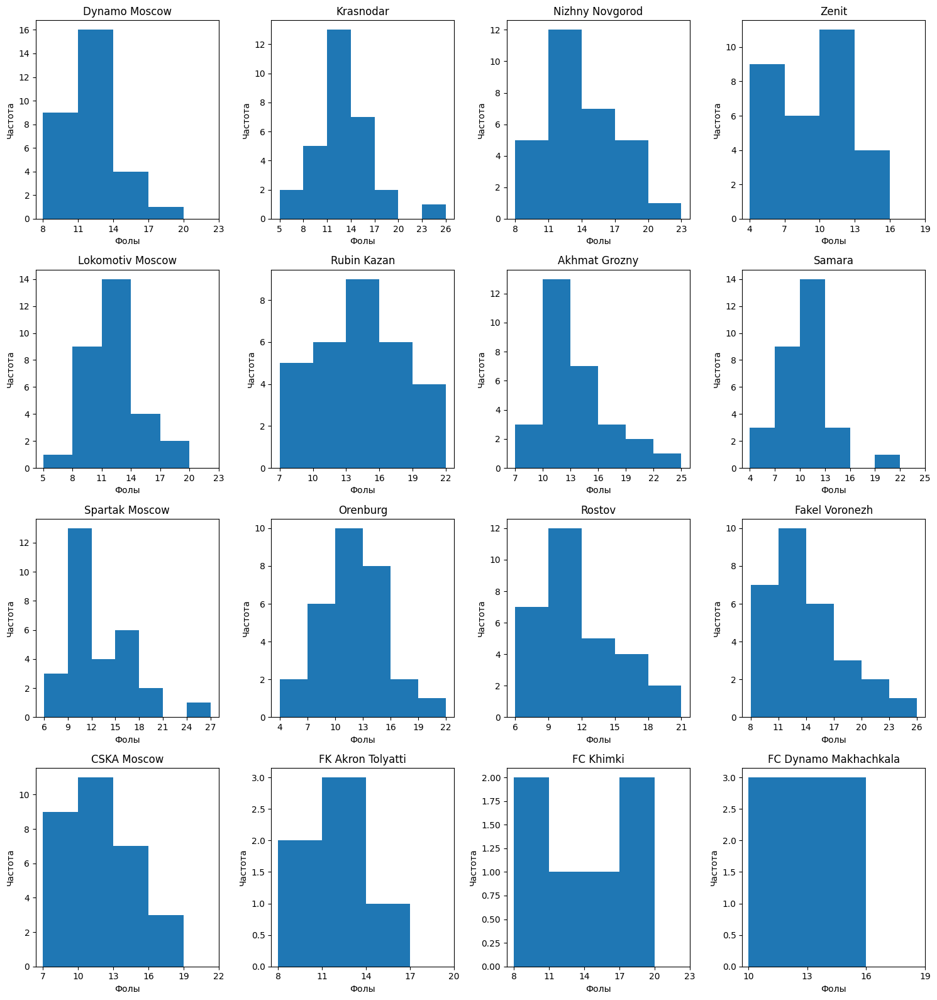

In [75]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Предположим, у тебя есть DataFrame с именем fouls_df, 
# содержащий столбцы 'Home', 'fouls_home', 'Away', 'fouls_away'

# Создаем словарь для хранения данных о фолах для каждой команды
all_teams_fouls = {}

# Итерируемся по строкам DataFrame
for index, row in original_df.iterrows():
    home_team = row['Home']
    away_team = row['Away']
    home_fouls = row['fouls_home']
    away_fouls = row['fouls_away']

    # Добавляем фолы домашней команды
    if home_team in all_teams_fouls:
        all_teams_fouls[home_team].append(home_fouls)
    else:
        all_teams_fouls[home_team] = [home_fouls]

    # Добавляем фолы гостевой команды
    if away_team in all_teams_fouls:
        all_teams_fouls[away_team].append(away_fouls)
    else:
        all_teams_fouls[away_team] = [away_fouls]

# Определяем количество строк и столбцов для сабплотов
n_teams = len(all_teams_fouls)
n_cols = 4  # Количество столбцов 
n_rows = (n_teams + n_cols - 1) // n_cols  # Вычисляем количество строк

# Создаем фигуру и оси для сабплотов
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 4*n_rows))

# Индекс для перебора сабплотов
plot_index = 0

# Строим гистограммы для каждой команды
for team, fouls in all_teams_fouls.items():
    # Определяем текущие строку и столбец для сабплота
    row = plot_index // n_cols
    col = plot_index % n_cols

    # Строим гистограмму на соответствующем сабплоте
    axes[row, col].hist(fouls, bins=range(int(min(fouls)), int(max(fouls)) + 4, 3))
    axes[row, col].set_title(f'{team}')
    axes[row, col].set_xlabel('Фолы')
    axes[row, col].set_ylabel('Частота')

    # Настраиваем шаг меток на оси X
    min_tick = min(fouls)
    max_tick = max(fouls) + 4 # Добавляем 4, чтобы последняя метка отображалась
    axes[row, col].set_xticks(np.arange(min_tick, max_tick + 1, 3))

    plot_index += 1

# Удаляем пустые сабплоты, если количество команд не кратно количеству столбцов
if plot_index < n_rows * n_cols:
    for i in range(plot_index, n_rows * n_cols):
        fig.delaxes(axes.flatten()[i])

# Настройка расположения сабплотов
plt.tight_layout()
plt.show()

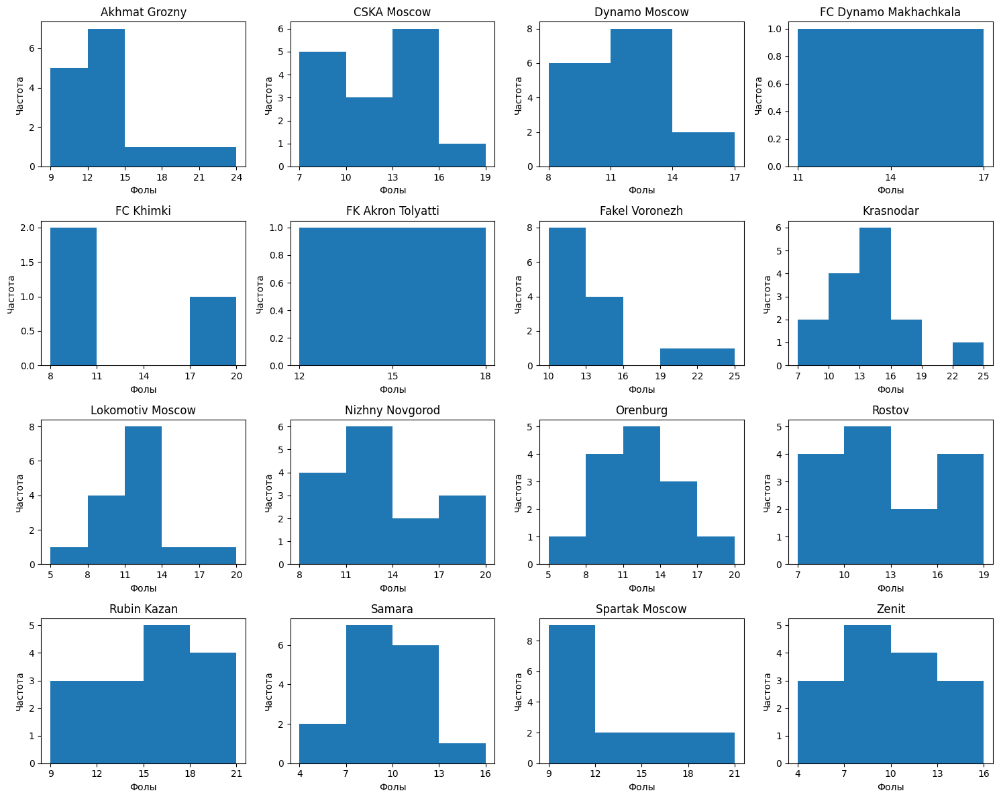

In [77]:
import matplotlib.pyplot as plt
import pandas as pd 
%matplotlib inline 

# Предположим, у тебя есть DataFrame с именем fouls_df, содержащий столбцы 'Home', 'fouls_home'


# Группируем данные по домашним командам
home_teams = original_df.groupby('Home')

# Определяем количество строк и столбцов для сабплотов
n_rows = 4  # Количество строк
n_cols = 4  # Количество столбцов

# Создаем фигуру и оси для сабплотов
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 12)) 

# Индекс для перебора сабплотов
plot_index = 0

# Создаем гистограммы для каждой команды
for team, data in home_teams:
    # Определяем текущие строку и столбец для сабплота
    row = plot_index // n_cols 
    col = plot_index % n_cols
    
    # Извлекаем данные о фолах для текущей команды
    fouls = data['fouls_home']
    
    # Строим гистограмму на соответствующем сабплоте
    axes[row, col].hist(fouls, bins=range(int(min(fouls)), int(max(fouls)) + 4, 3)) # Шаг = 3
    axes[row, col].set_title(f'{team}')
    axes[row, col].set_xlabel('Фолы')
    axes[row, col].set_ylabel('Частота')

    # Настраиваем шаг меток на оси X
    min_tick = min(fouls)
    max_tick = max(fouls) + 3 # Добавляем 3 для корректного отображения последней метки
    axes[row, col].set_xticks(np.arange(min_tick, max_tick + 1, 3))

    plot_index += 1

# Удаляем пустые сабплоты, если количество команд меньше 16
if plot_index < n_rows * n_cols:
    for i in range(plot_index, n_rows * n_cols):
        fig.delaxes(axes.flatten()[i])

# Настройка расположения сабплотов
plt.tight_layout() 
plt.show()